Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [1]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys
import random

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset

In [3]:
random.seed(0)
np.random.seed(0)
import torch
#https://pytorch.org/docs/stable/notes/randomness.html
torch.manual_seed(0)
torch.backends.cudnn.benchmark = False
torch.use_deterministic_algorithms(True)
#https://discuss.pytorch.org/t/random-seed-with-external-gpu/102260/4

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [4]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [5]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

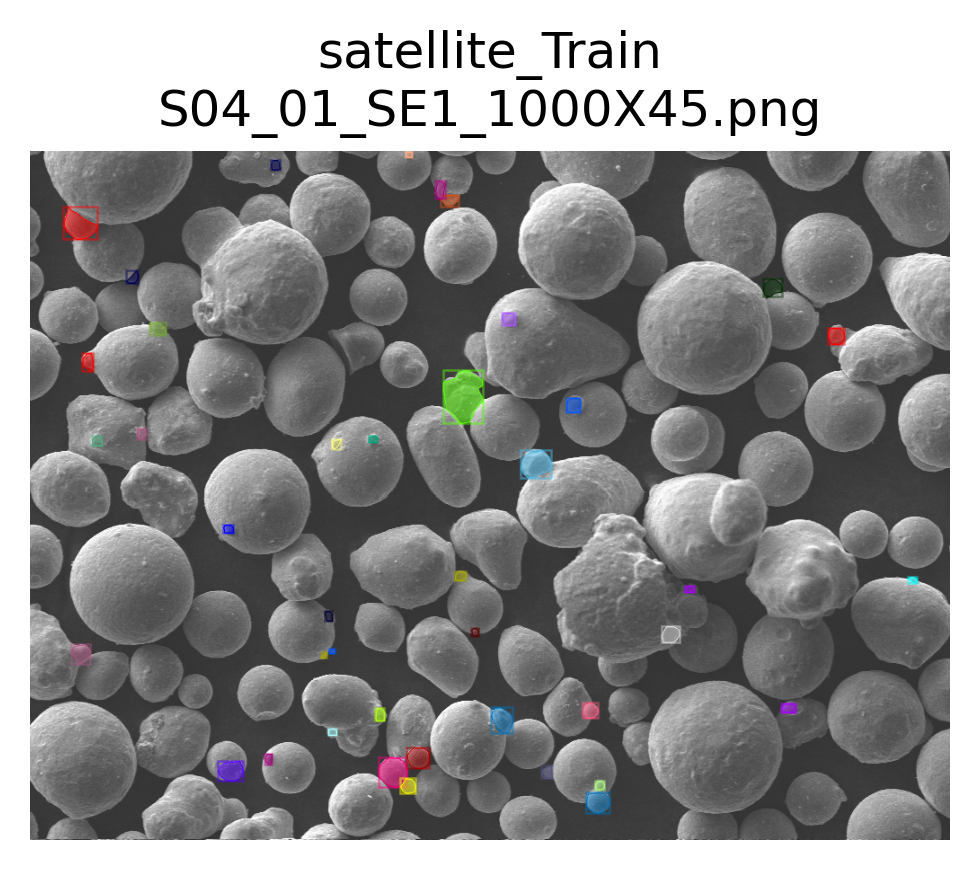

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 41


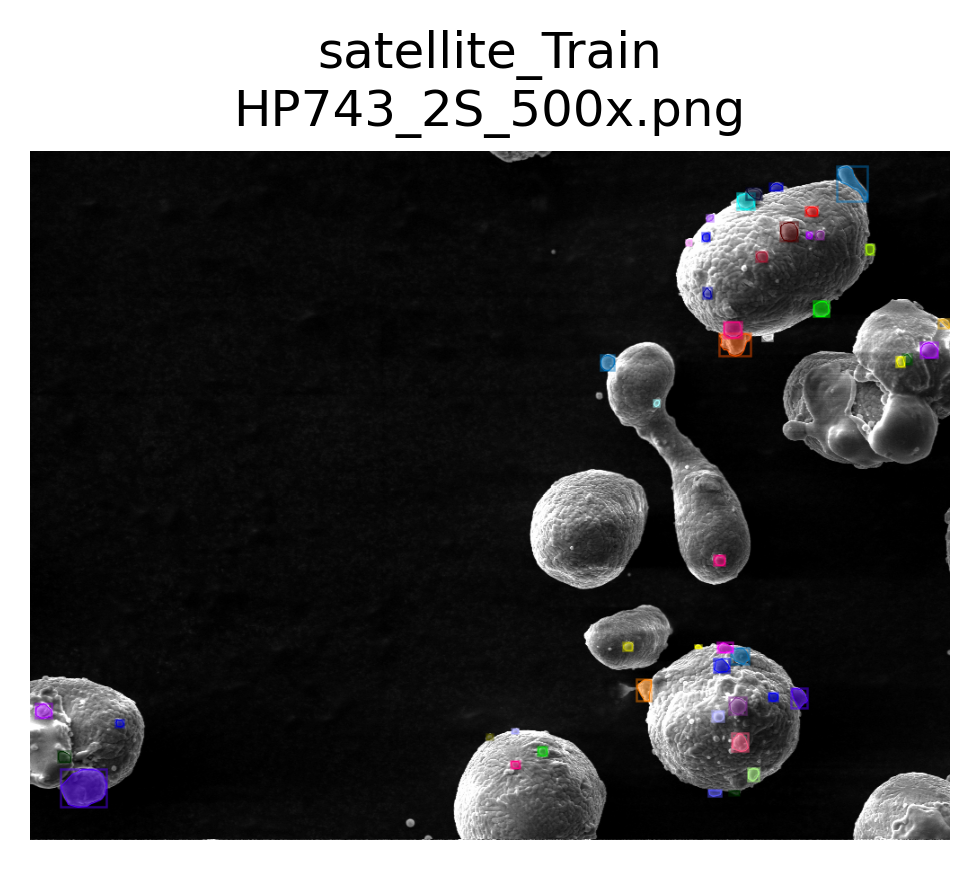

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 47


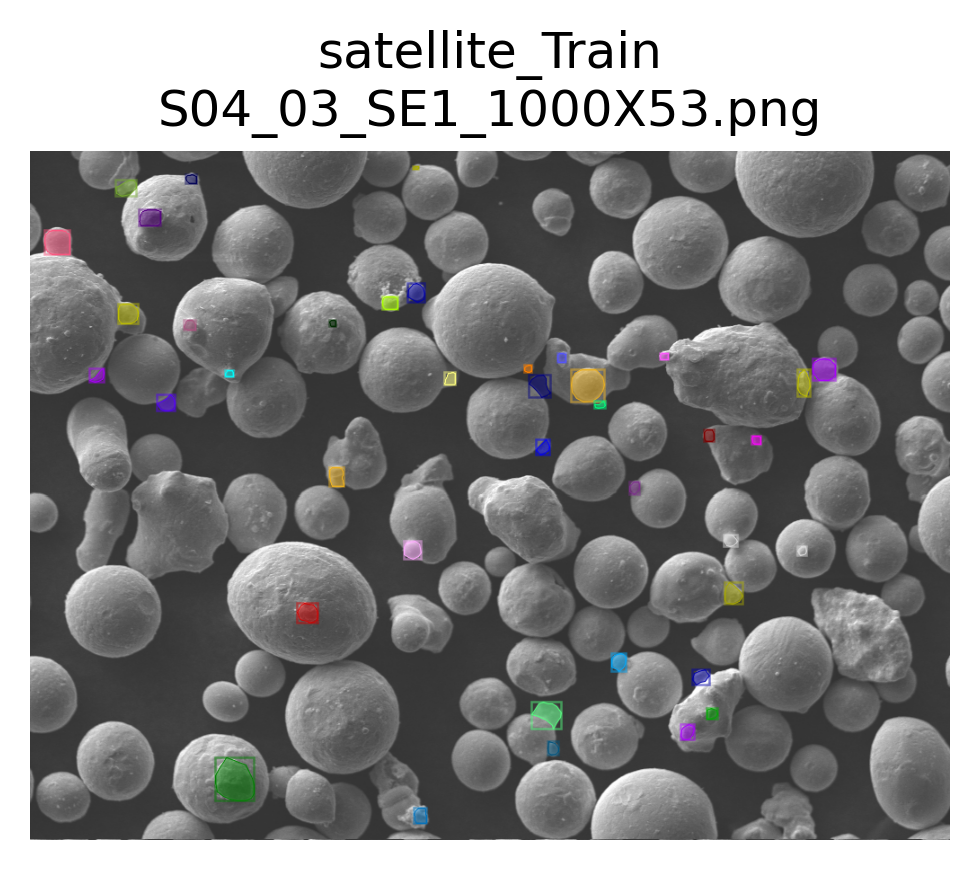

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 40


In [6]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

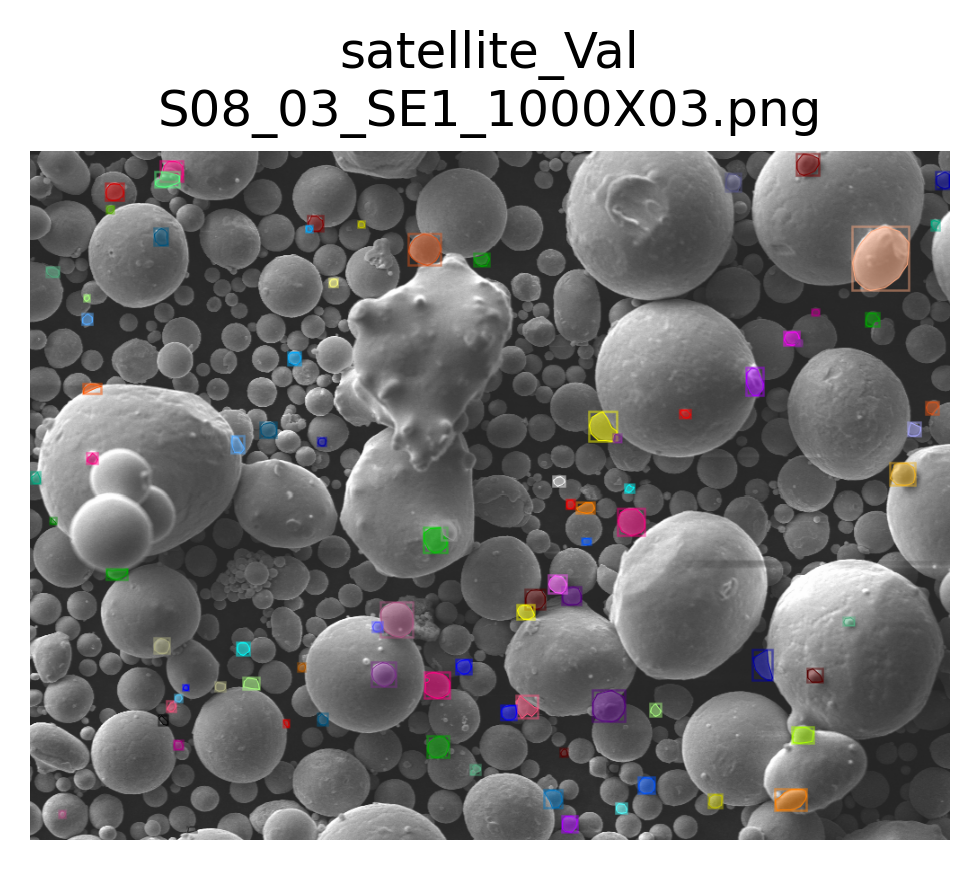

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


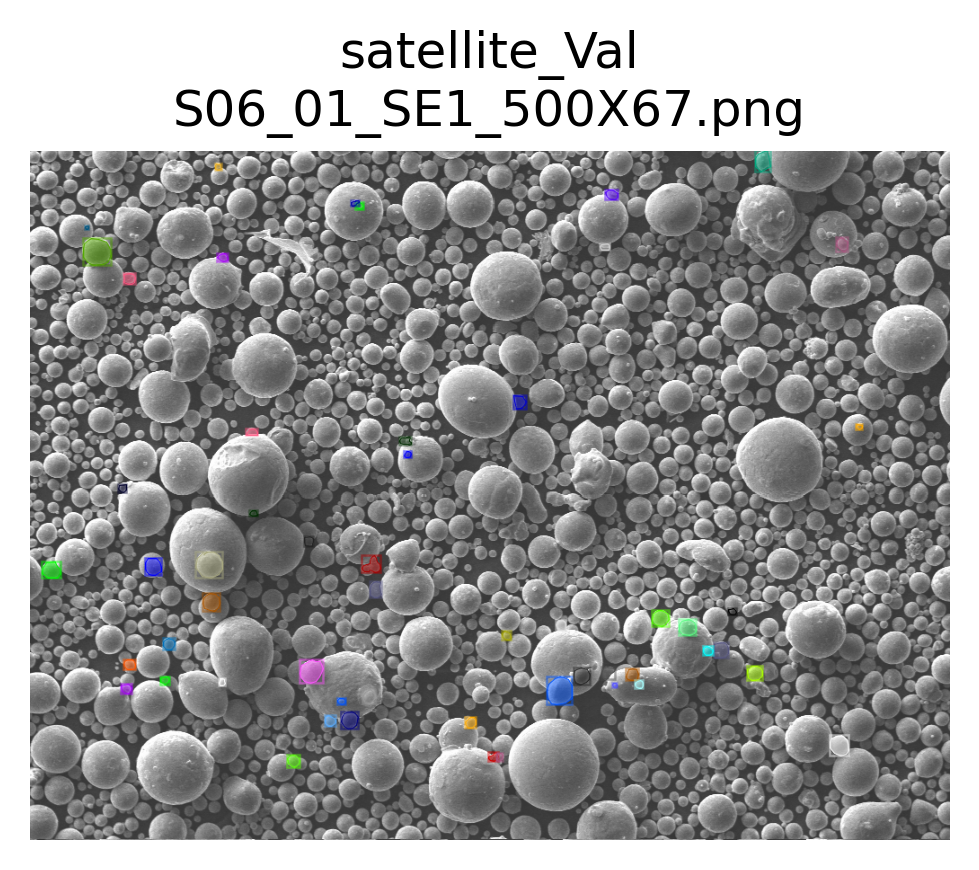

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


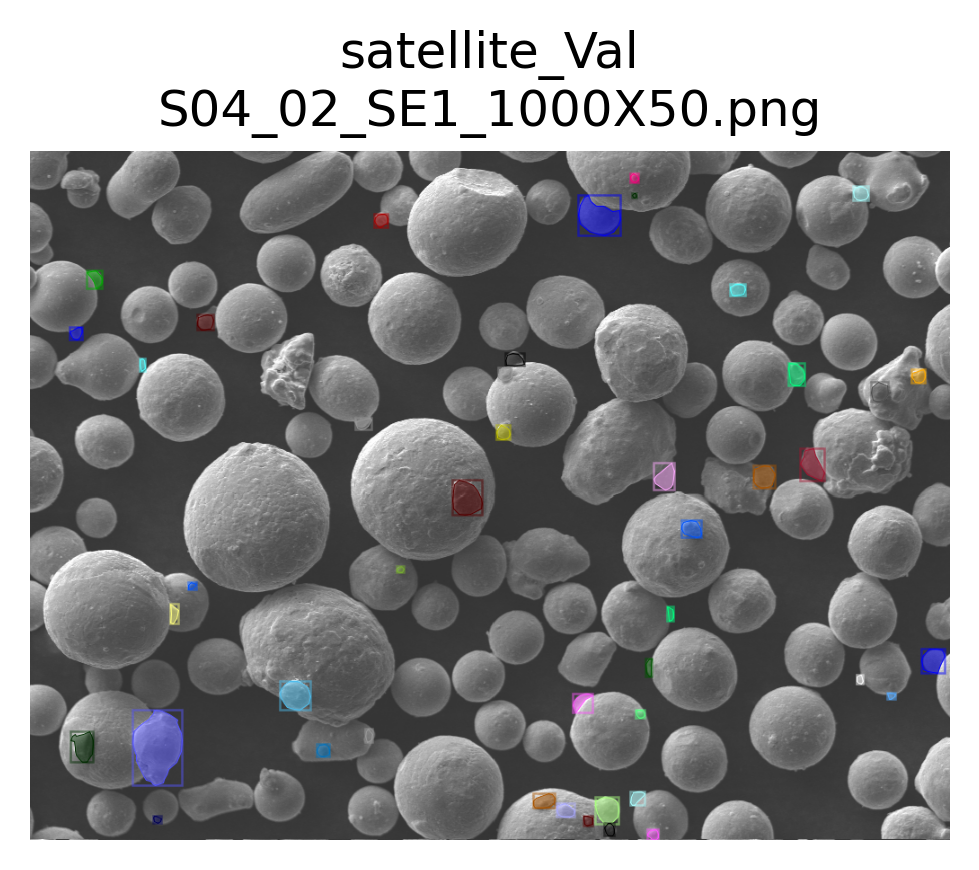

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


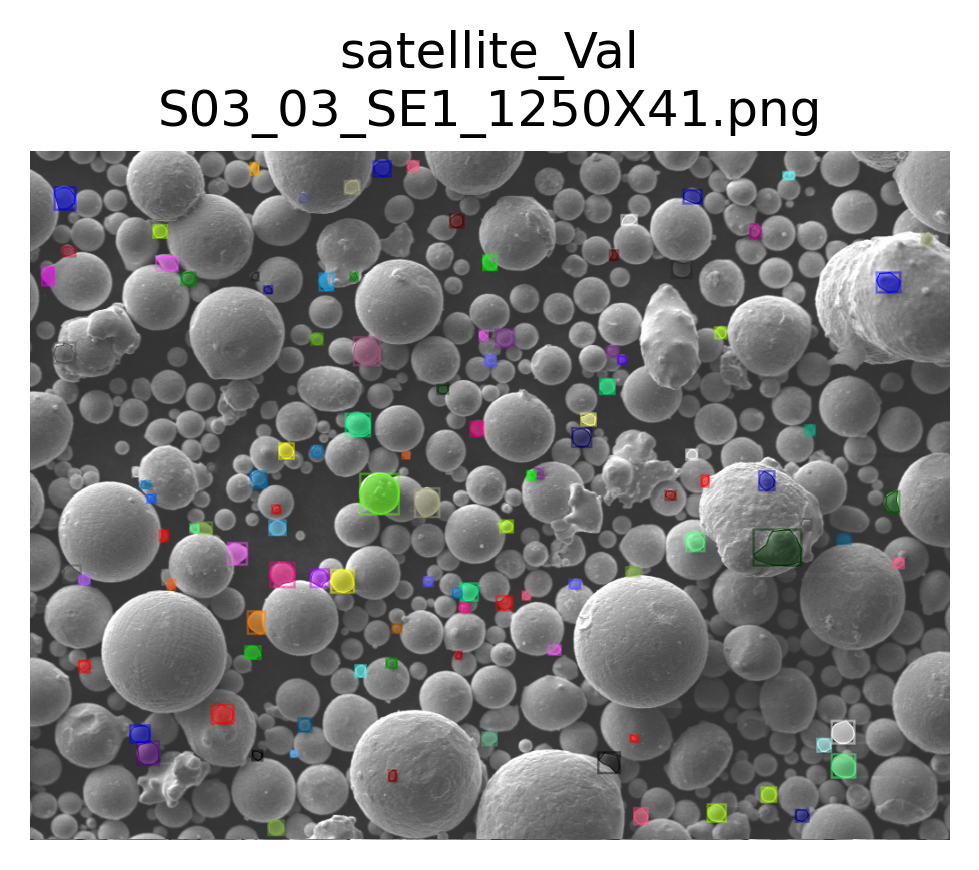

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


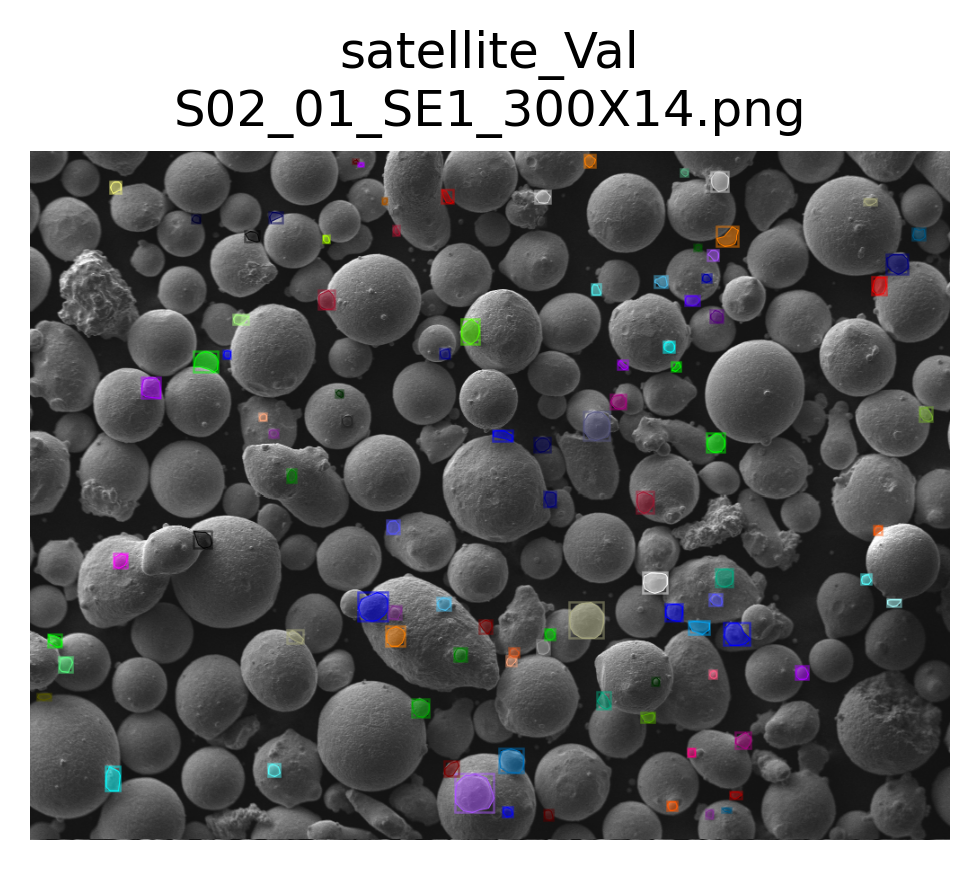

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


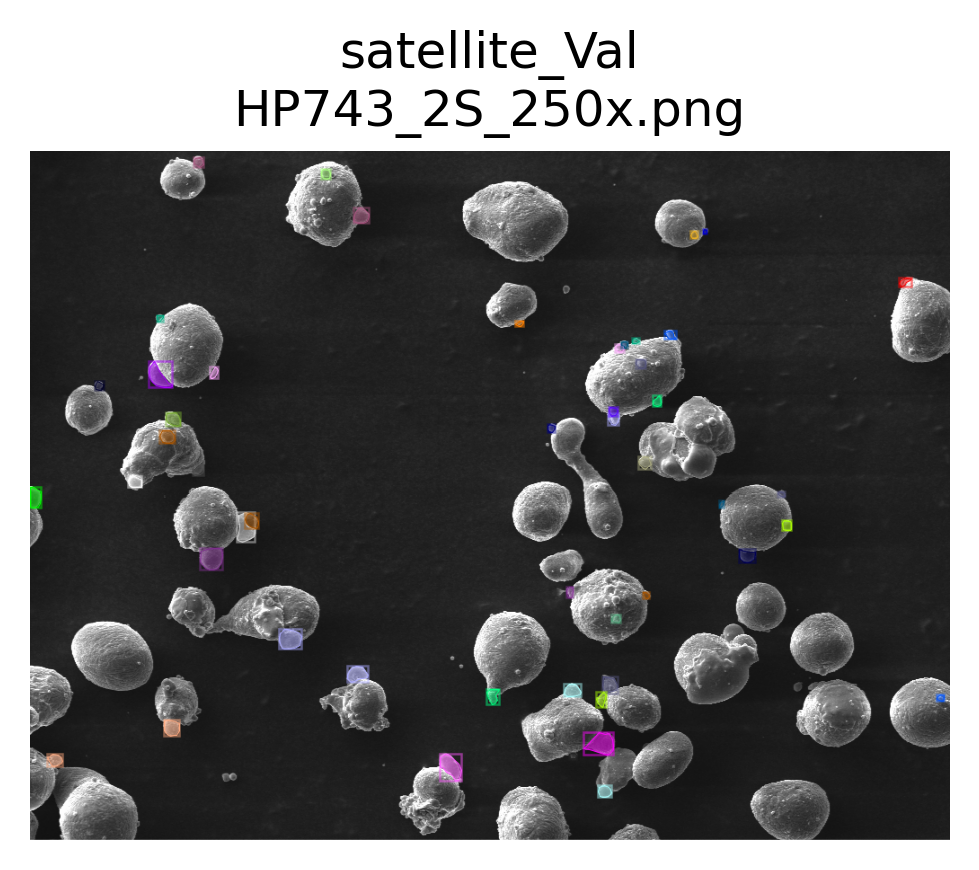

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [7]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [8]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 5000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path('DEMO_TEST'))
cfg.SEED = 1
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


In [9]:
print('--------------------------------')
print(cfg.SOLVER.BASE_LR)
print(cfg.SOLVER.WEIGHT_DECAY)
print(cfg.MODEL.RETINANET.SCORE_THRESH_TEST)
print(cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST)
print(cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH)
print(cfg.MODEL.ROI_HEADS.NUM_CLASSES)
print(cfg.SOLVER.IMS_PER_BATCH) 

--------------------------------
0.02
0.0001
0.5
0.5
0.5
1
1


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [10]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[10/30 15:45:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[10/30 15:45:50 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[10/30 15:45:50 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[10/30 15:45:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[10/30 15:45:50 d2.data.build]: Using training sampler TrainingSampler
[10/30 15:45:50 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[10/30 15:45:50 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [10/30 15:45:50 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[10/30 15:45:50 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[10/30 15:45:50 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[10/30 15:45:52 d2.engine.hooks]: Total training time: 0:00:01 (0:00:00 on hooks)
[10/30 15:45:52 d2.utils.events]:  iter: 0    lr: N/A  max_mem: 973M


RuntimeError: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#cublasApi_reproducibility

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [10]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


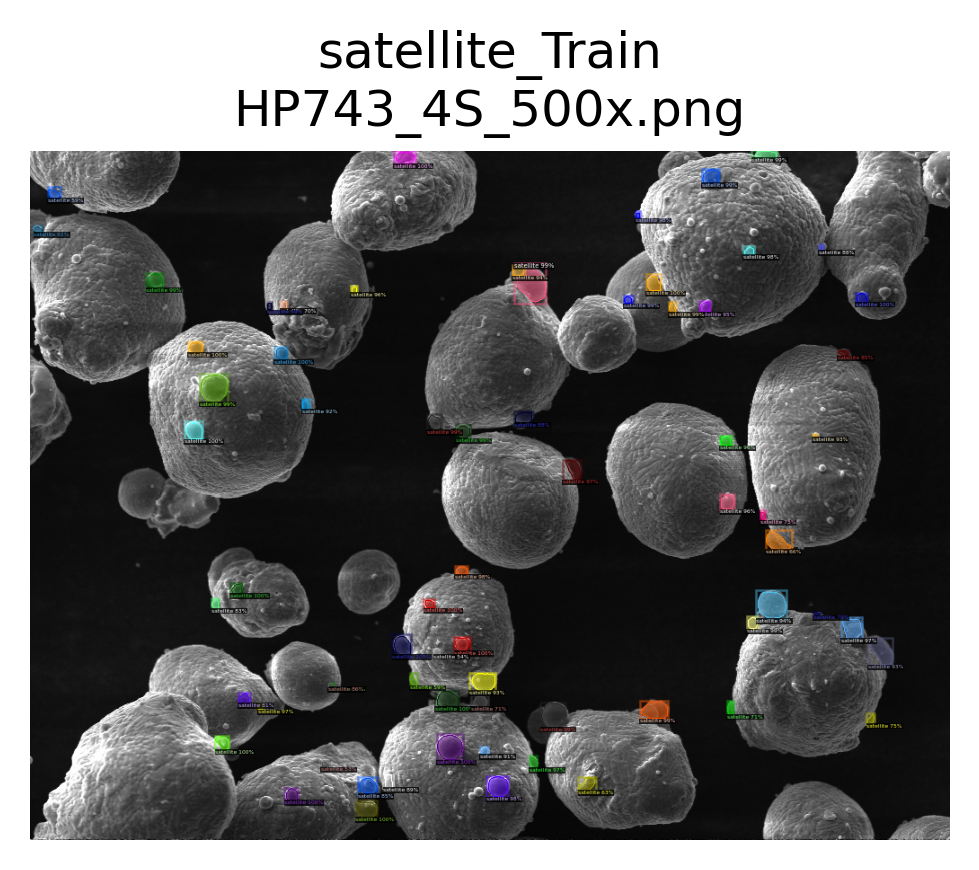

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 69
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


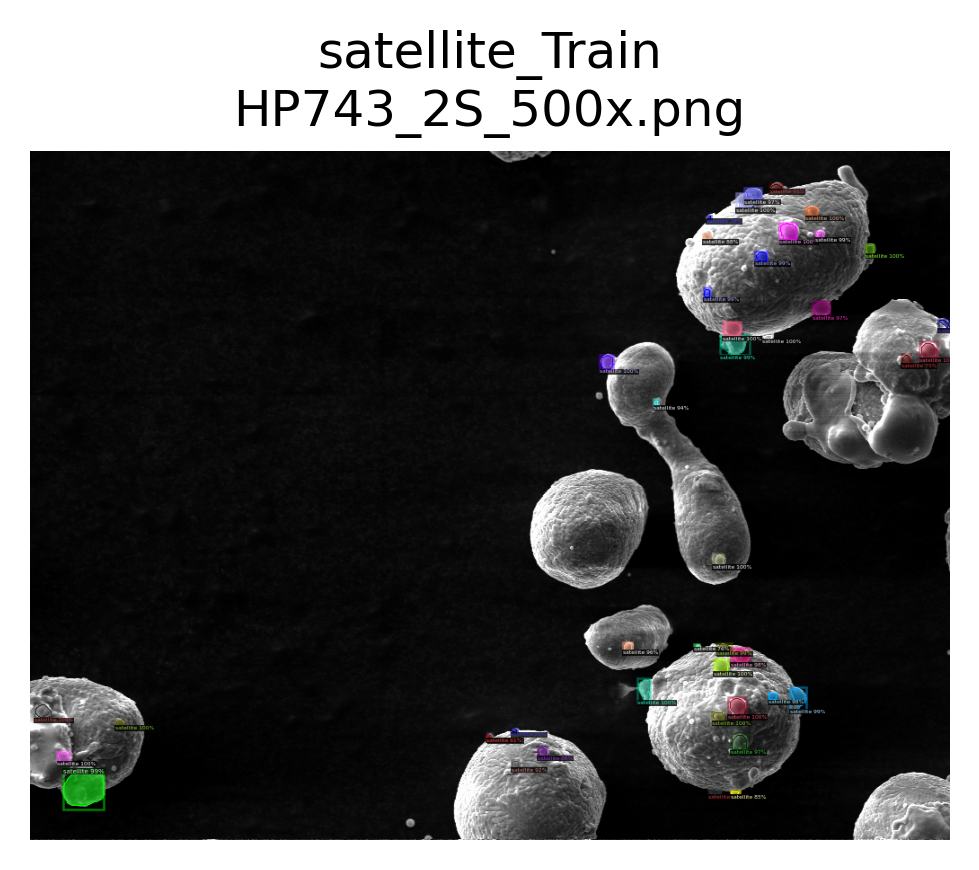

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 43
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


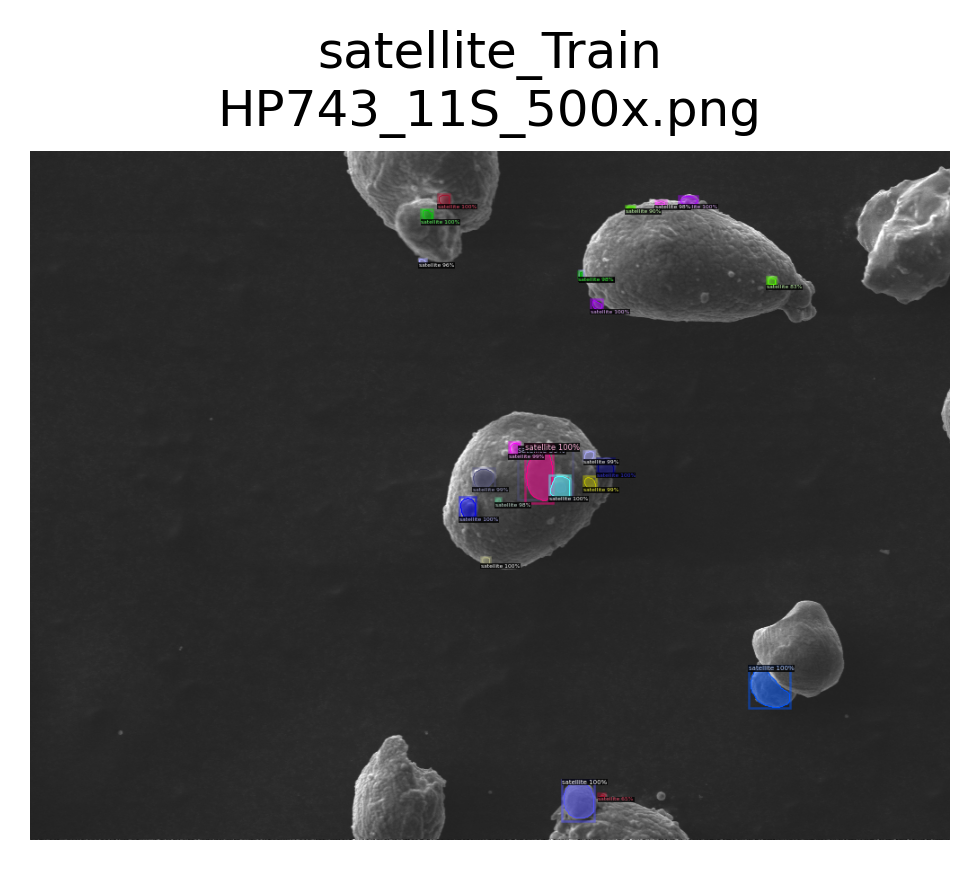

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 24
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


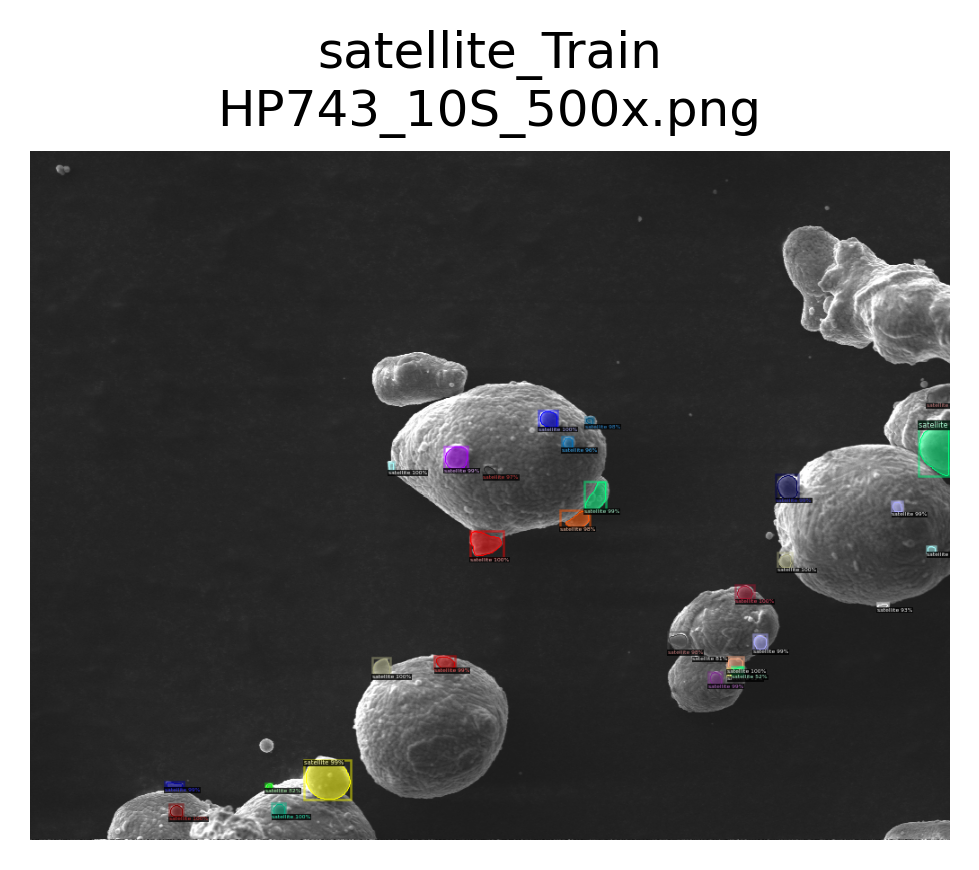

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 31
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


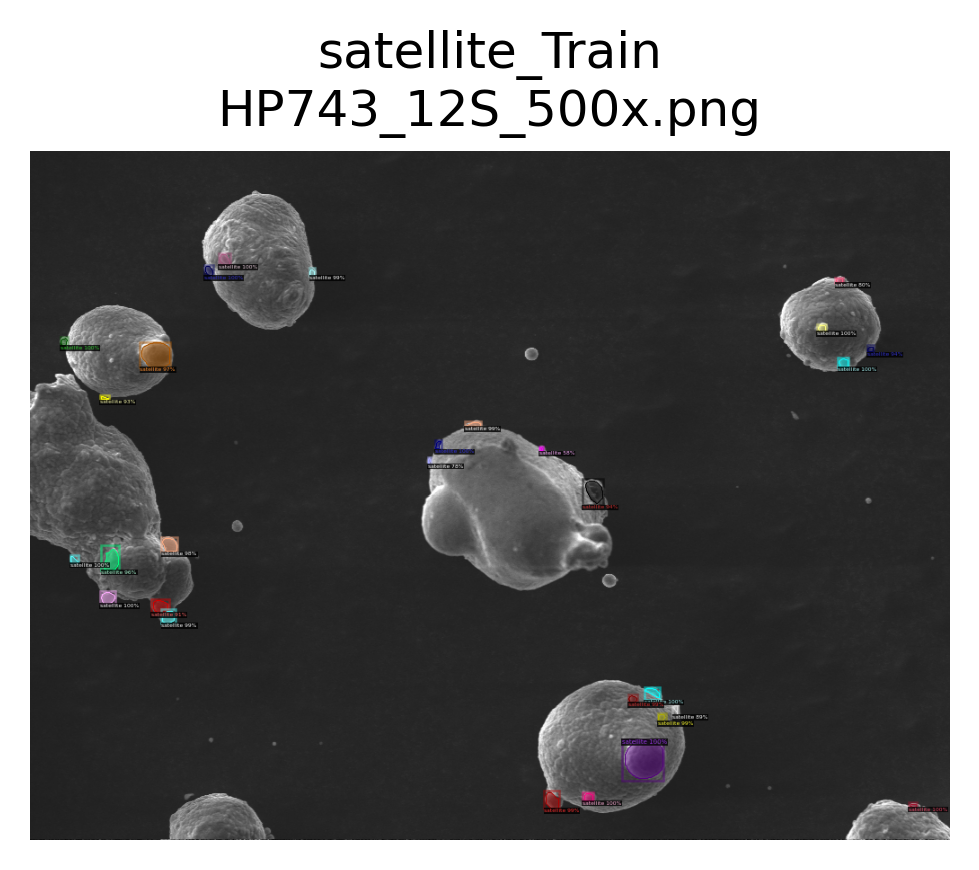

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 29
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


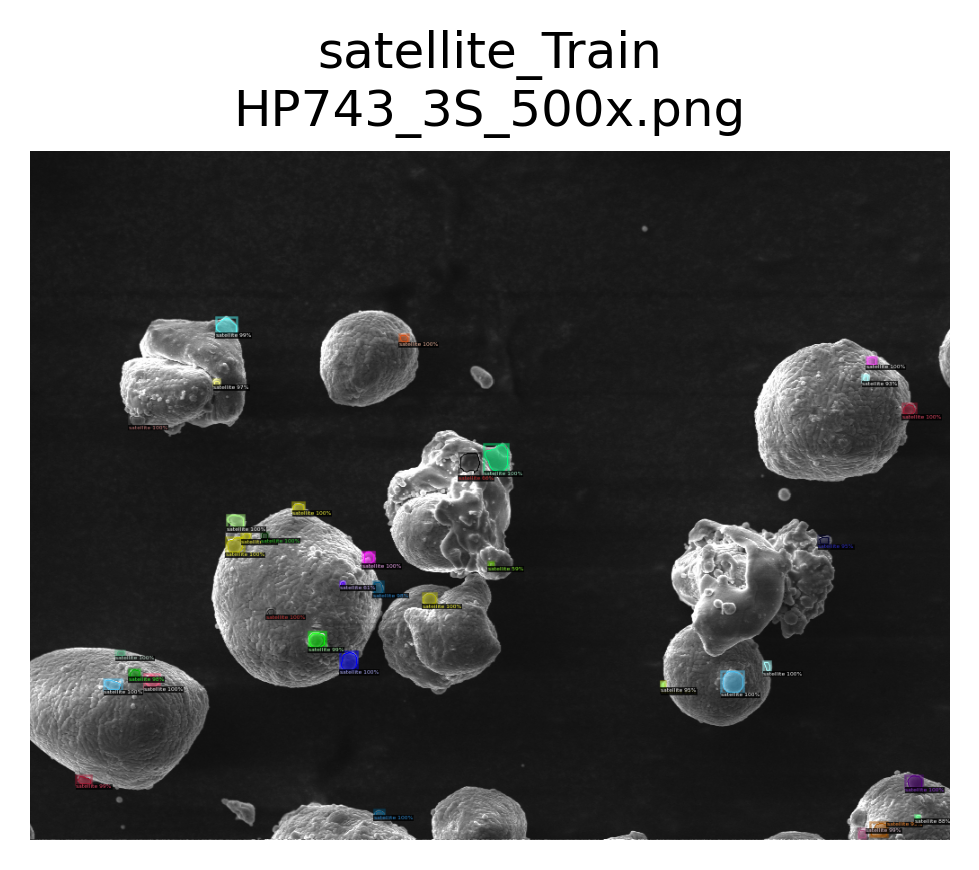

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


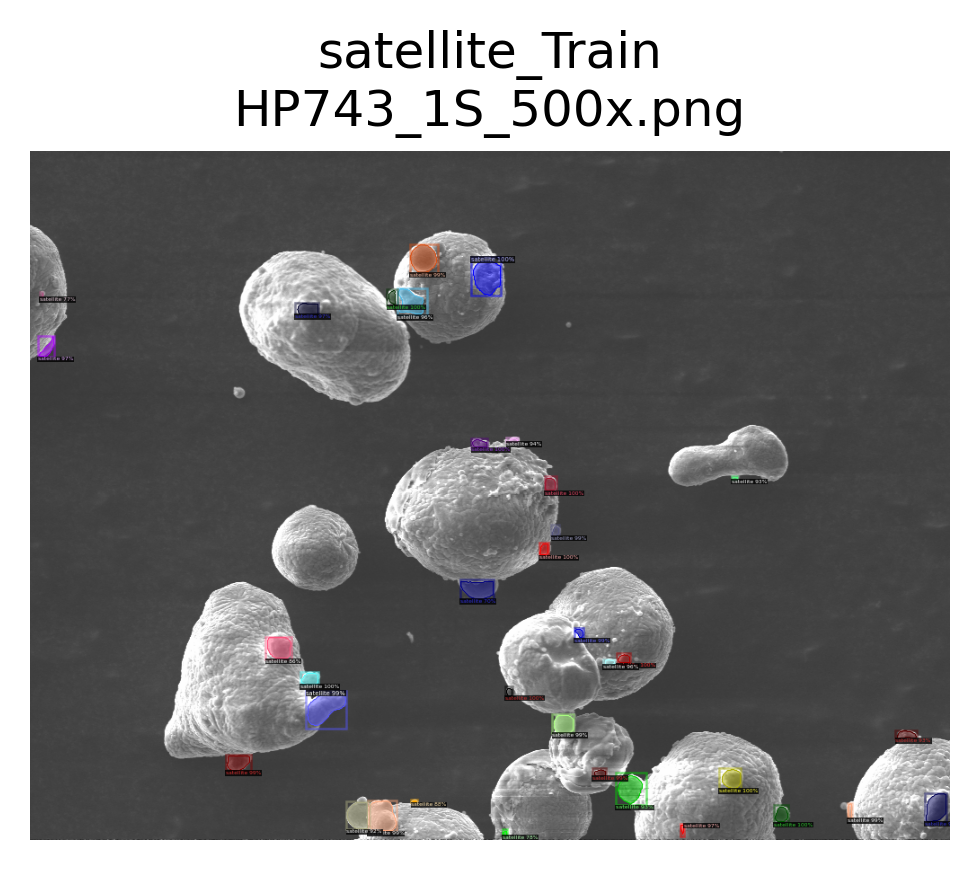

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 35
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


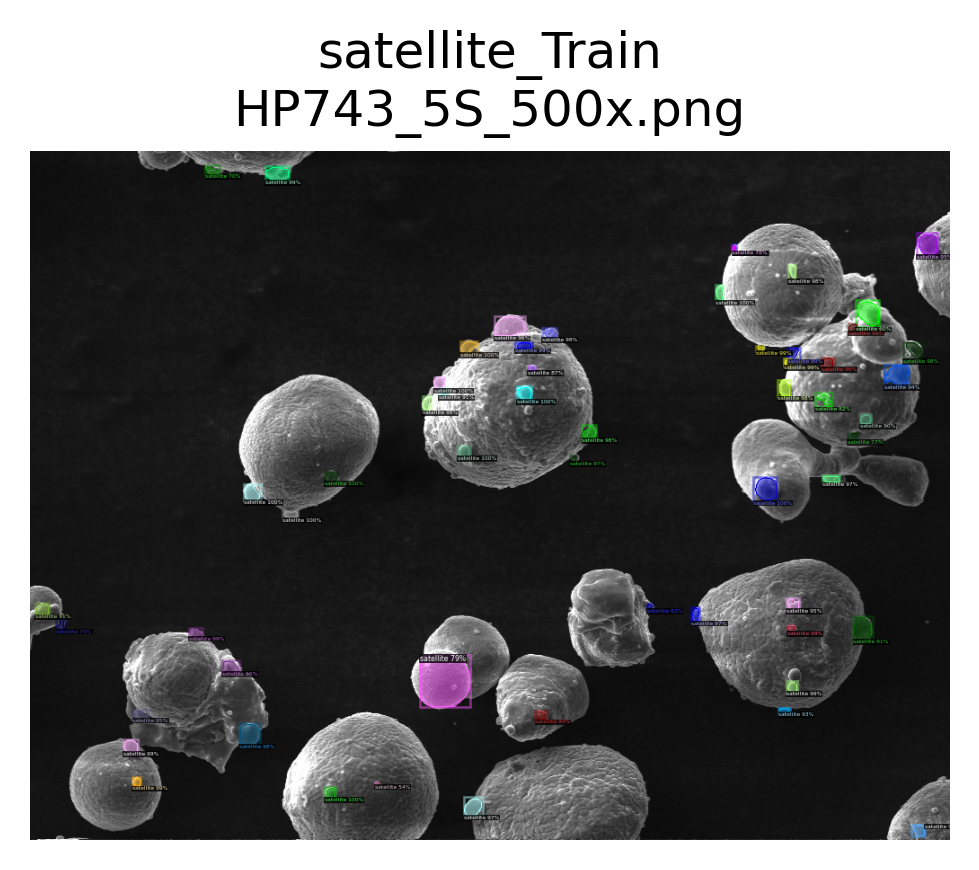

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 57
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


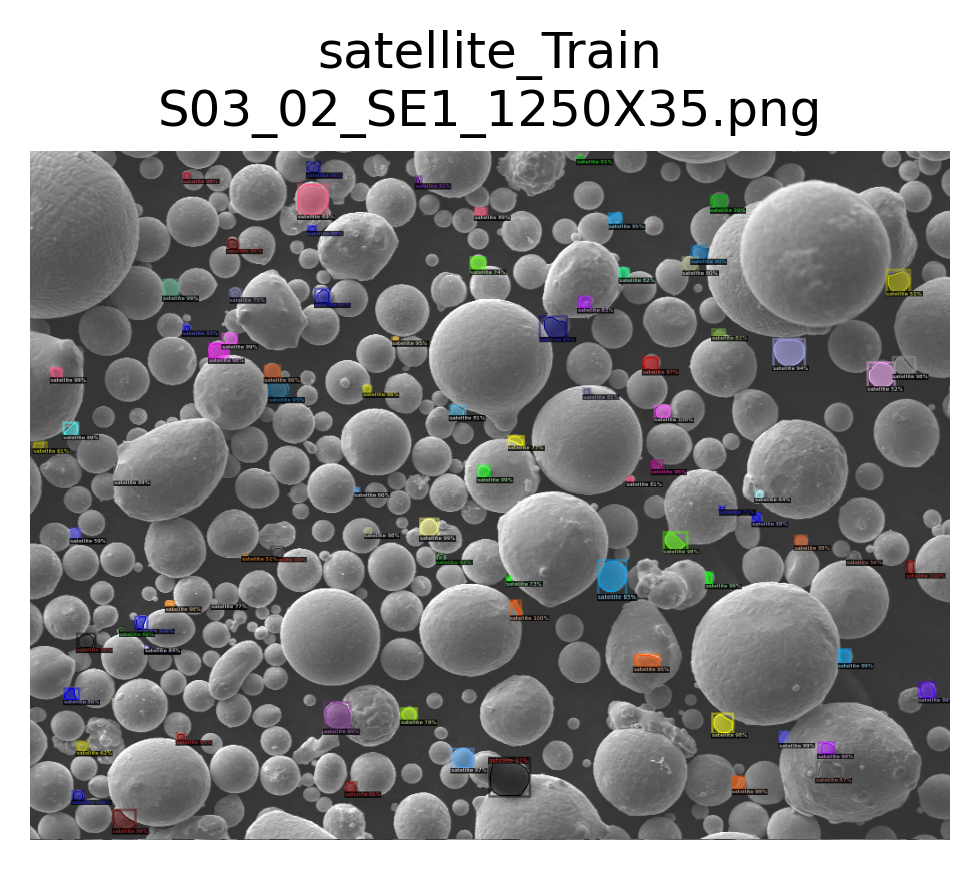

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 86
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


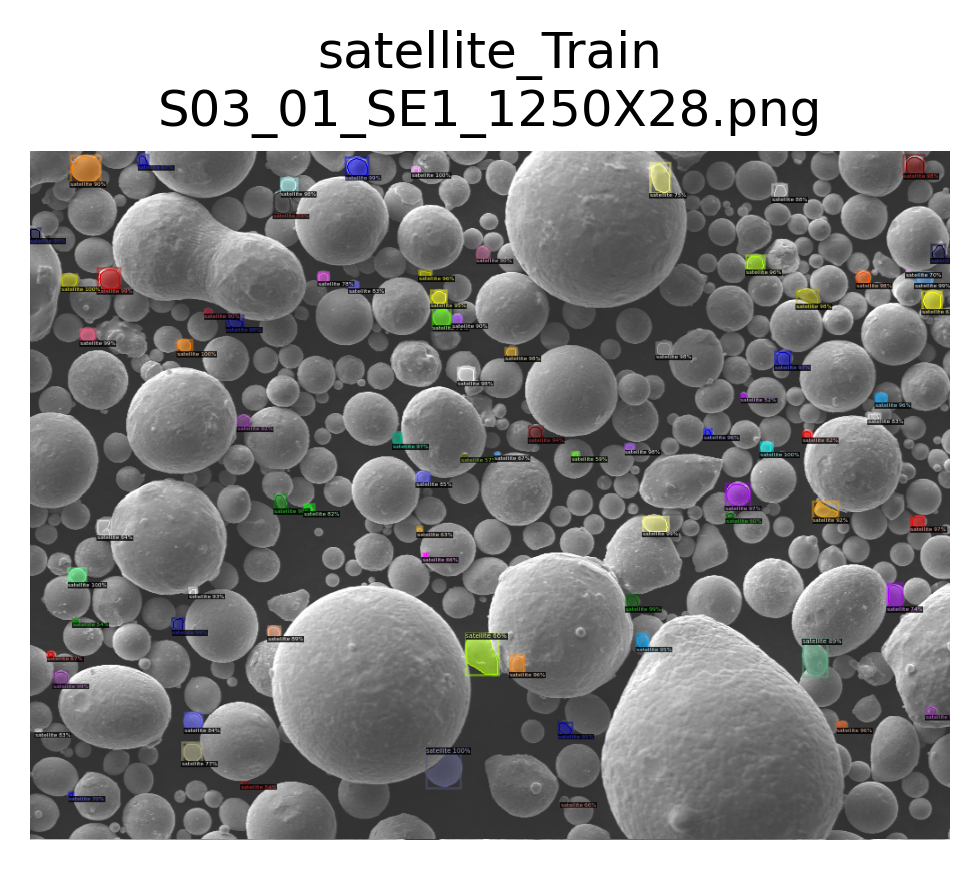

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 81
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


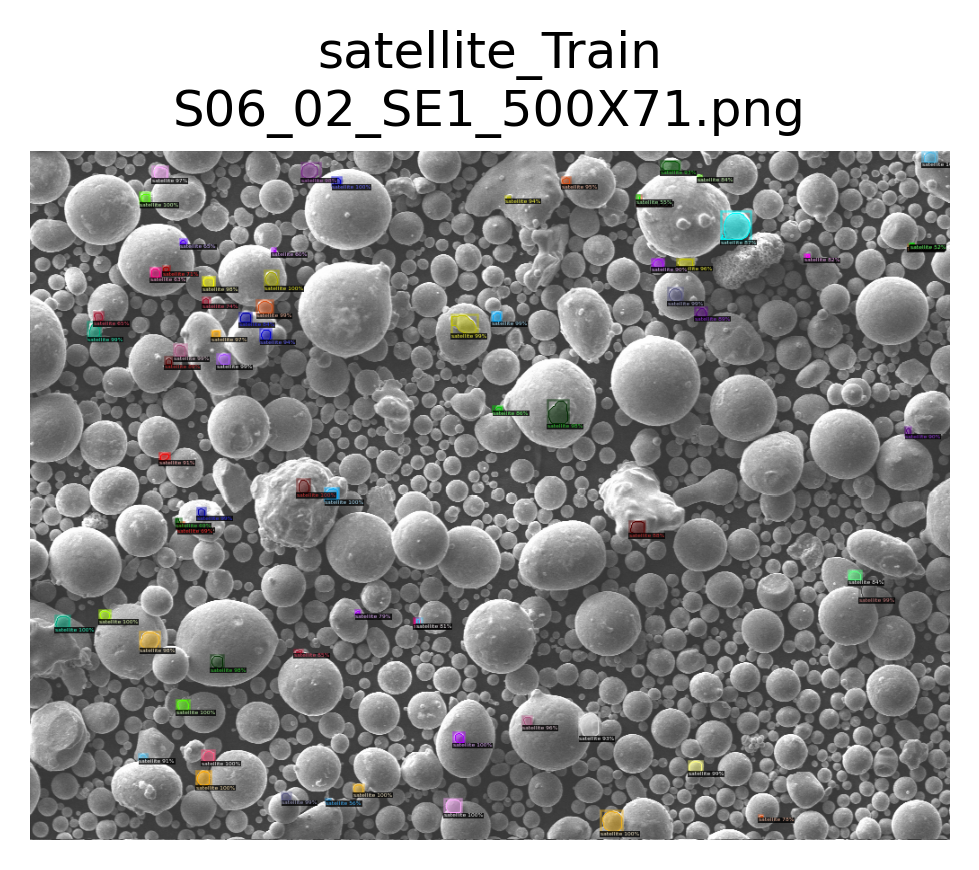

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 74
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


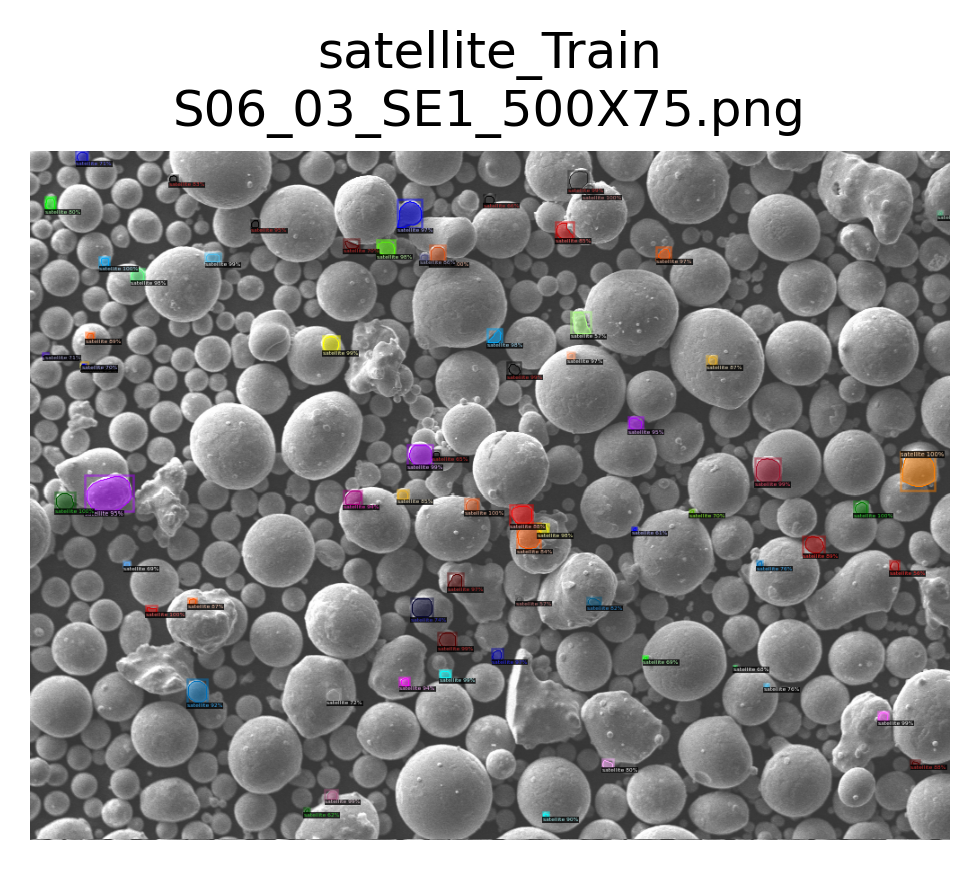

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 71
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


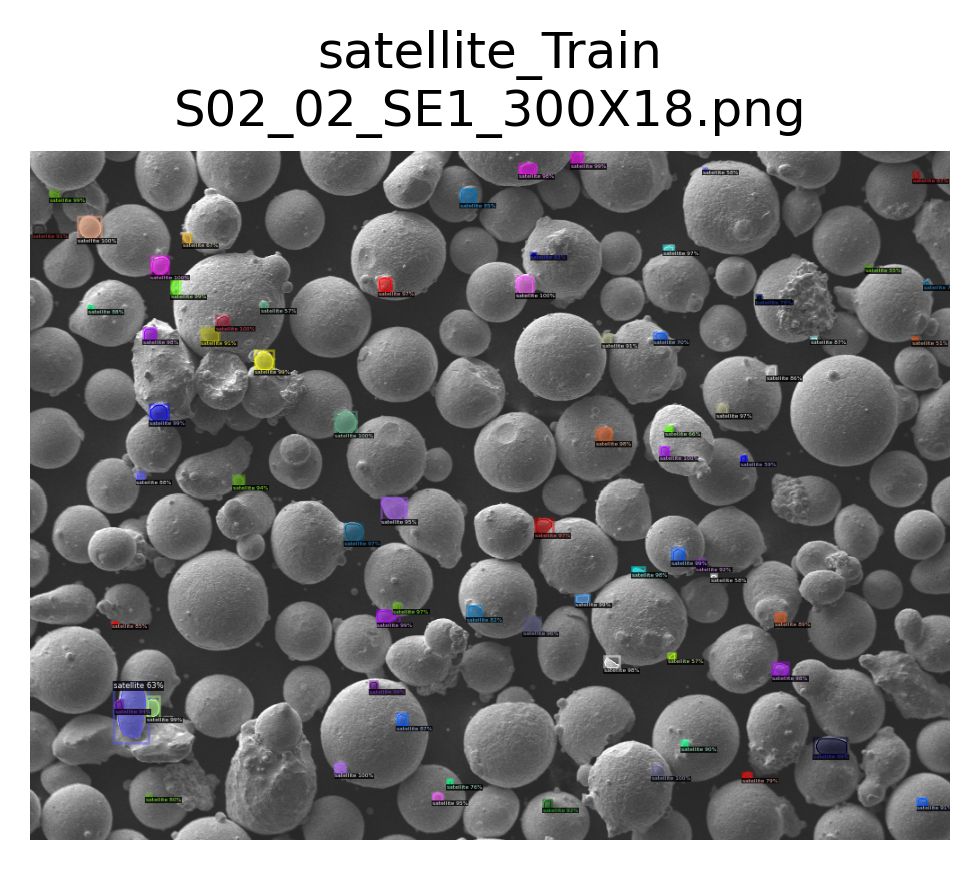

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 71
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


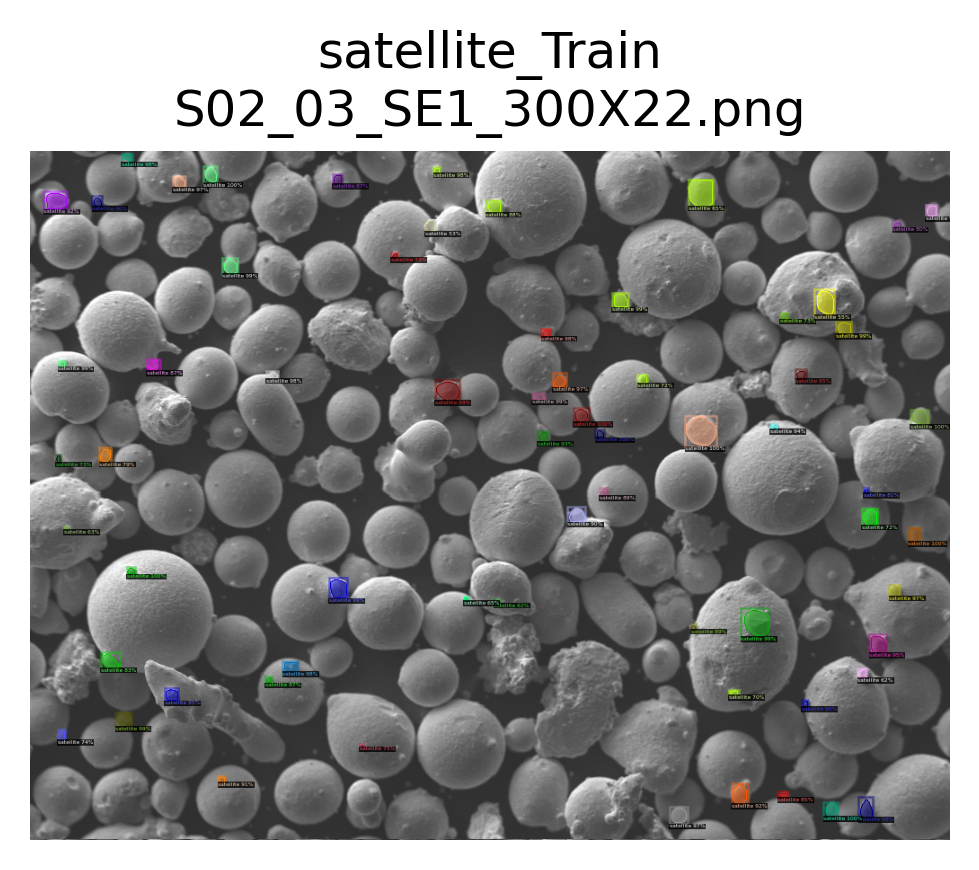

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 65
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


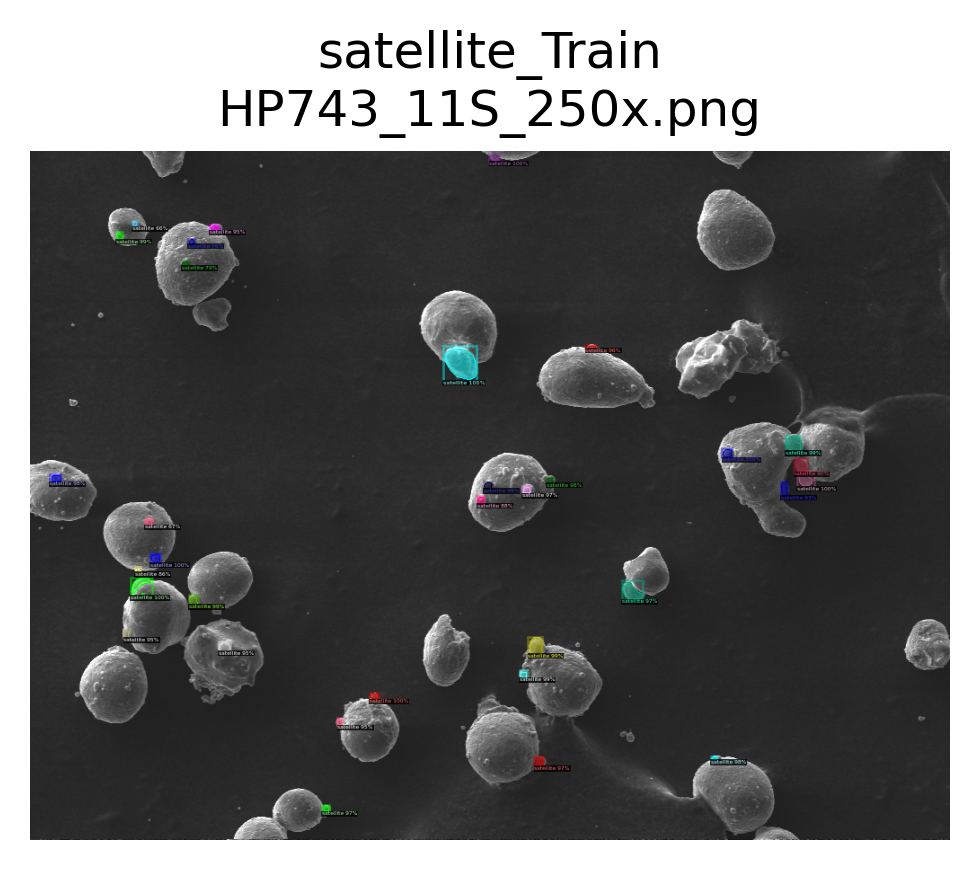

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


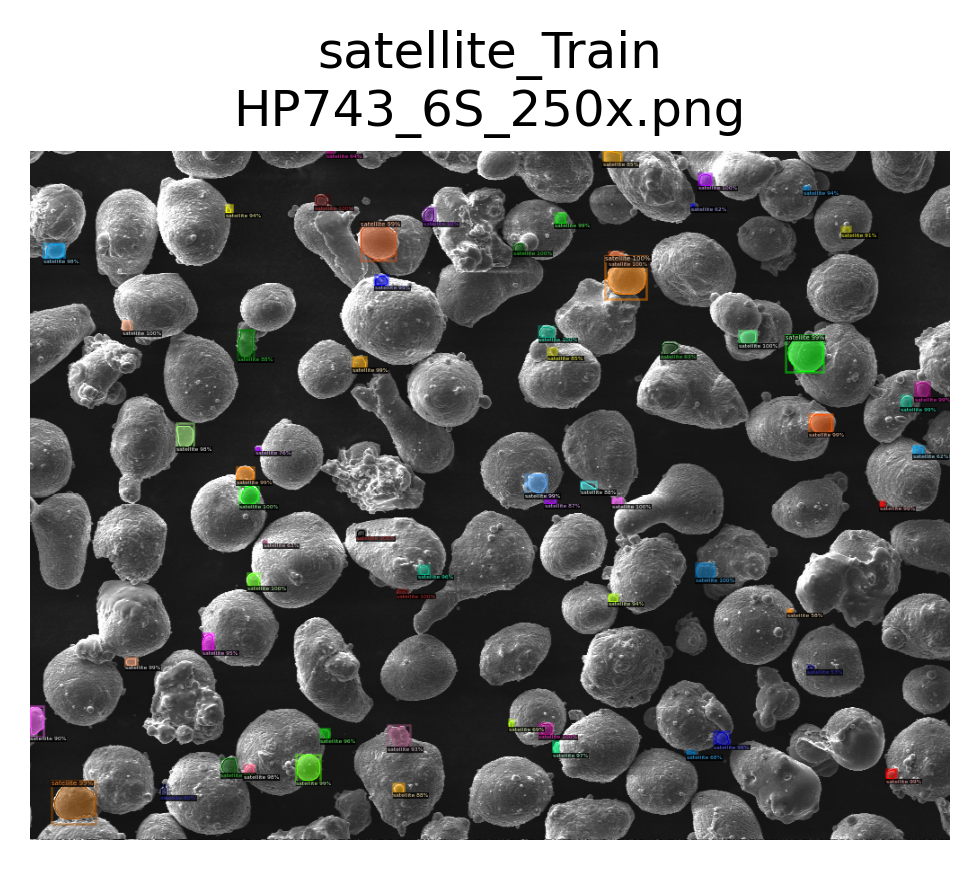

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 63
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


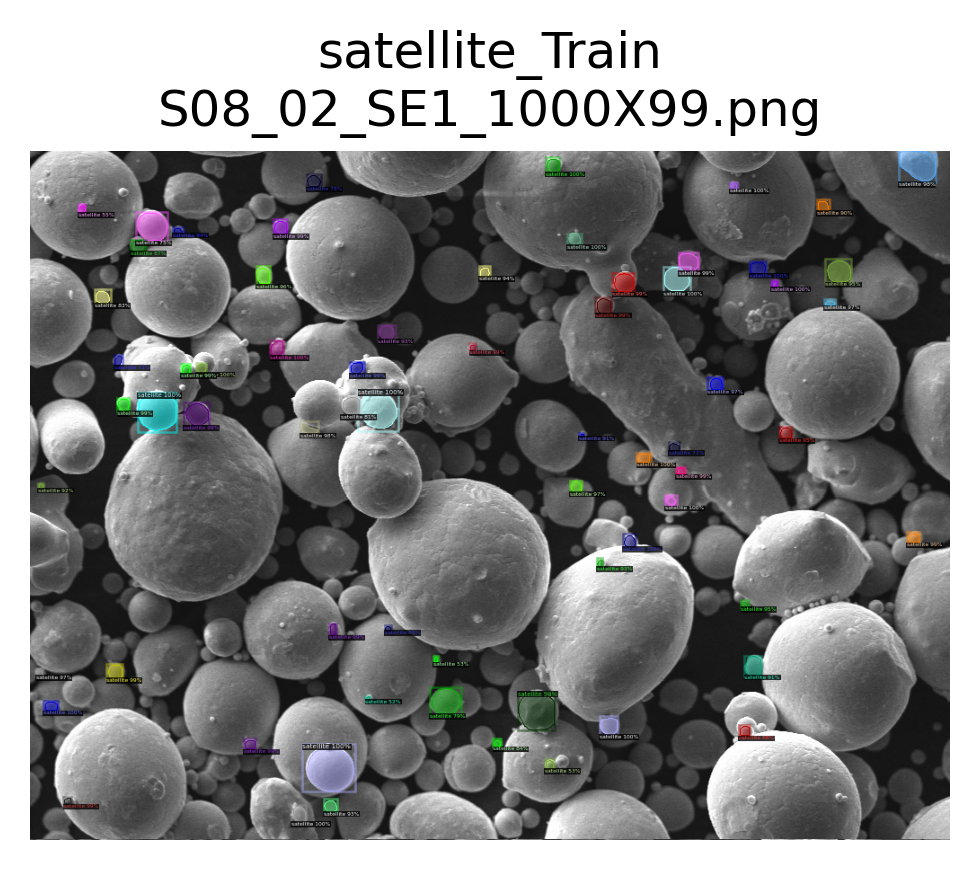

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 67
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


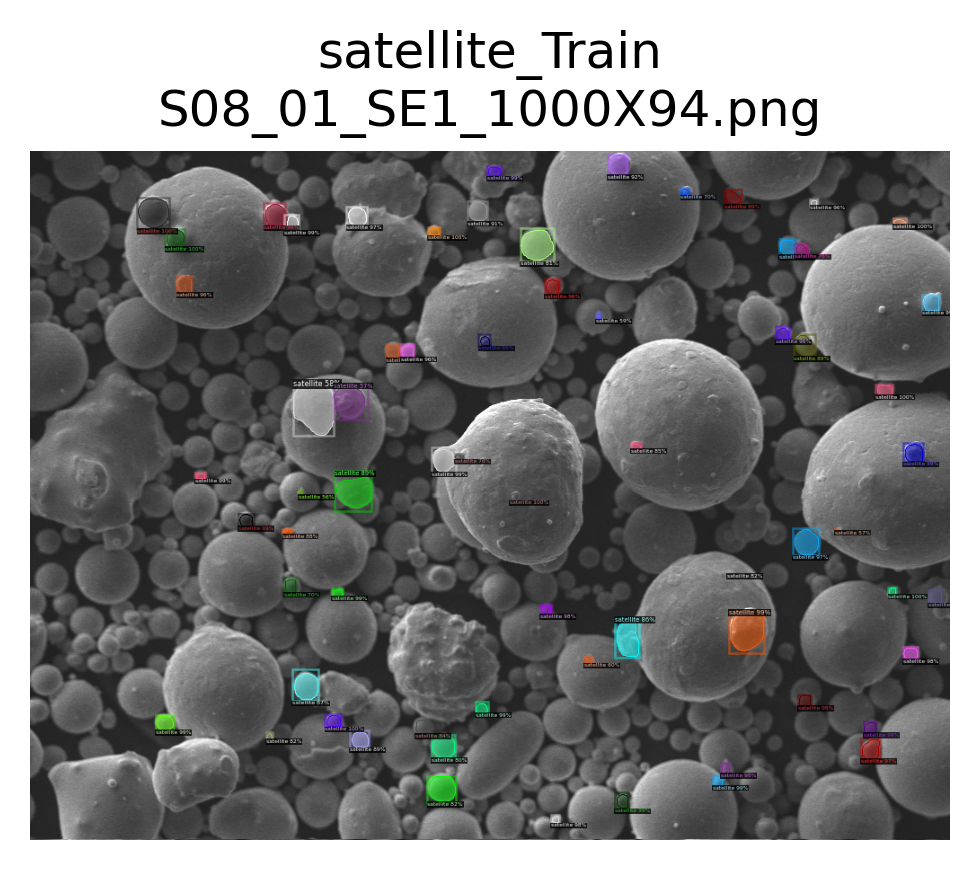

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 66
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


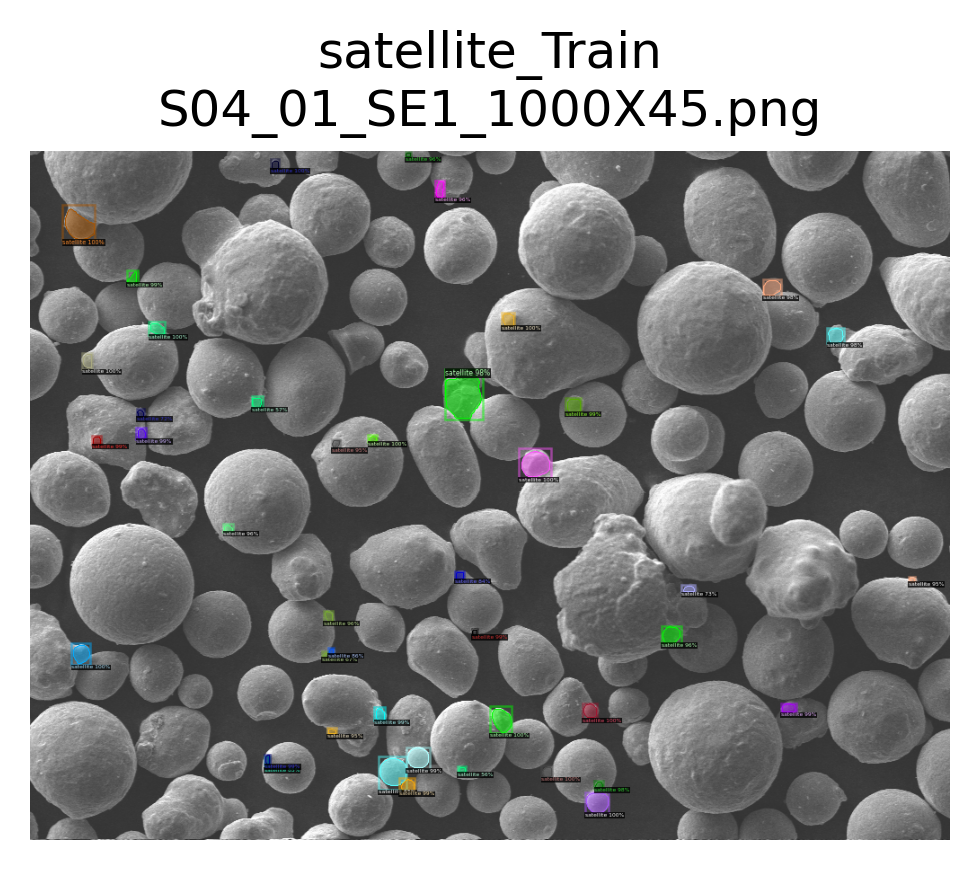

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 43
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


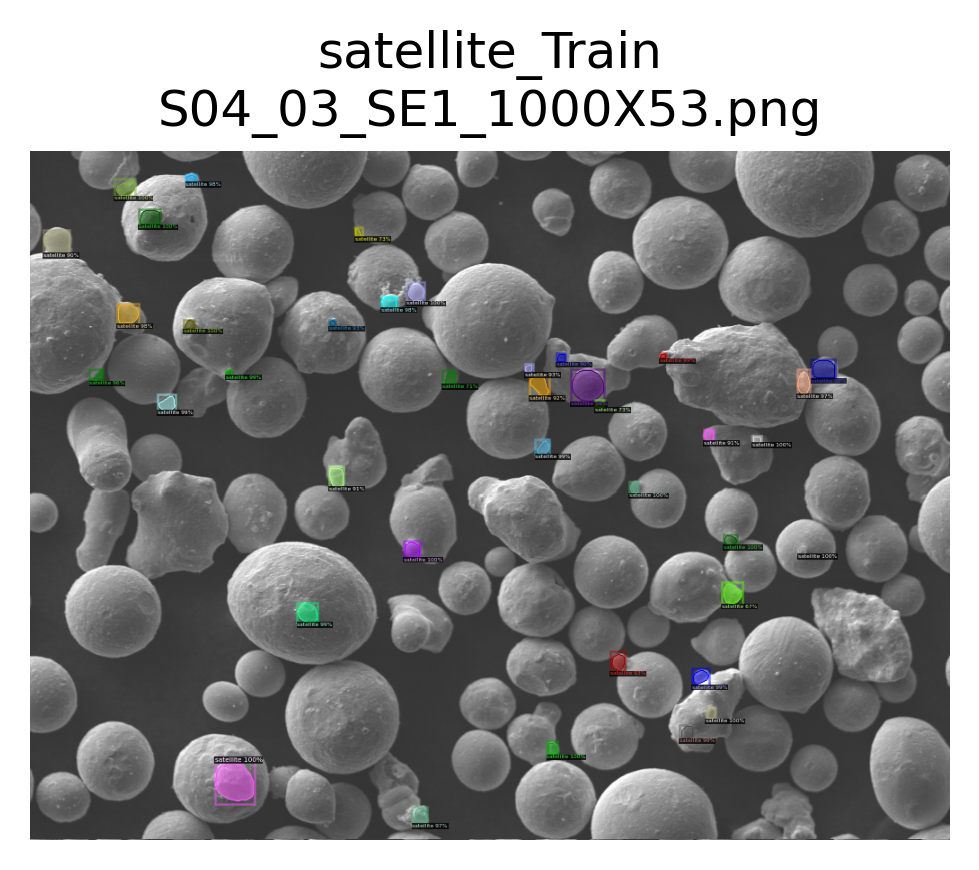

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 39
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


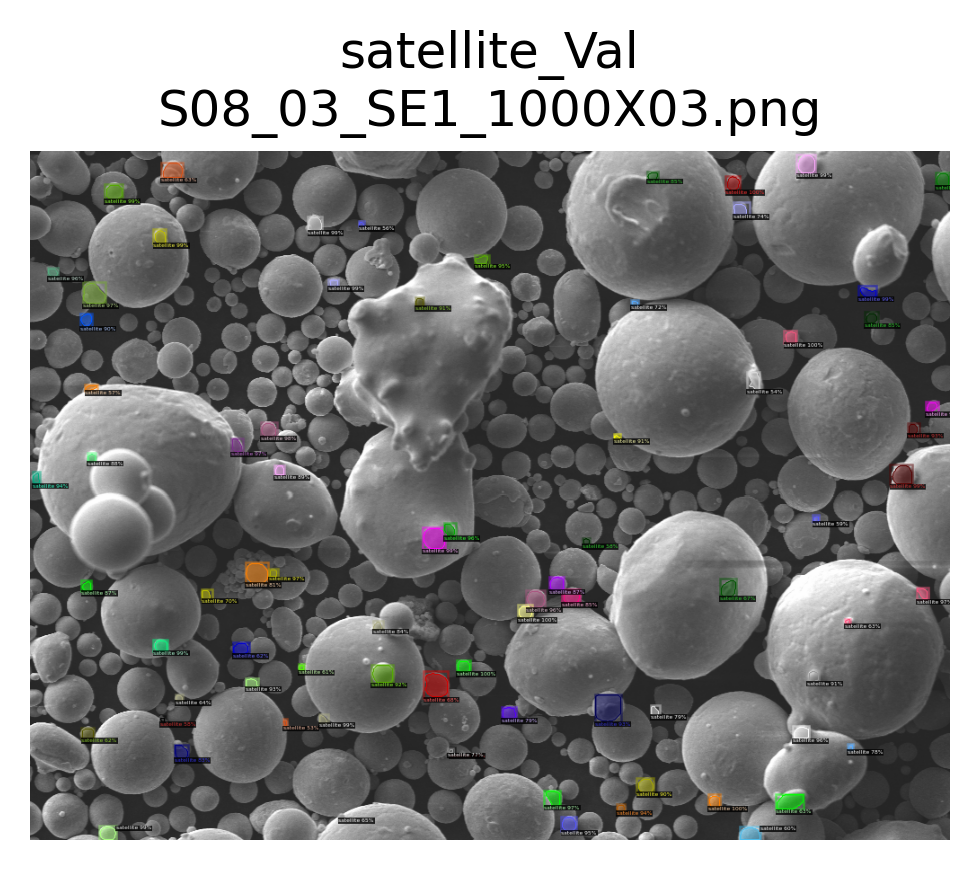

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


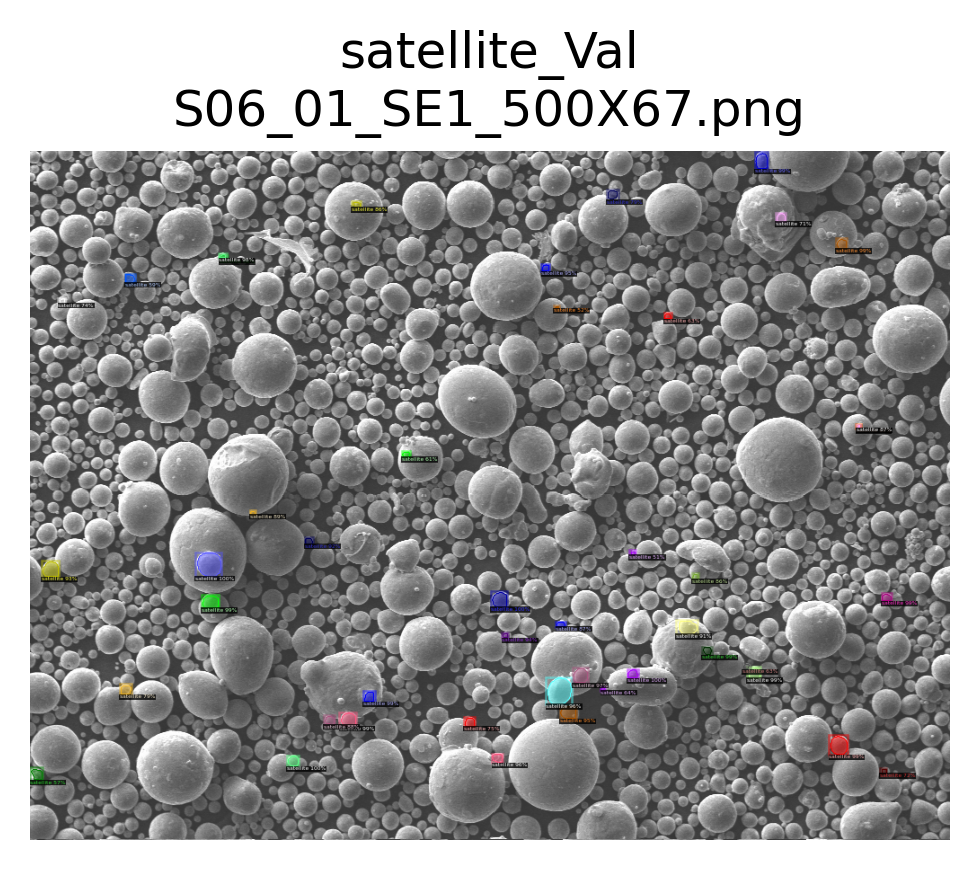

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 45
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


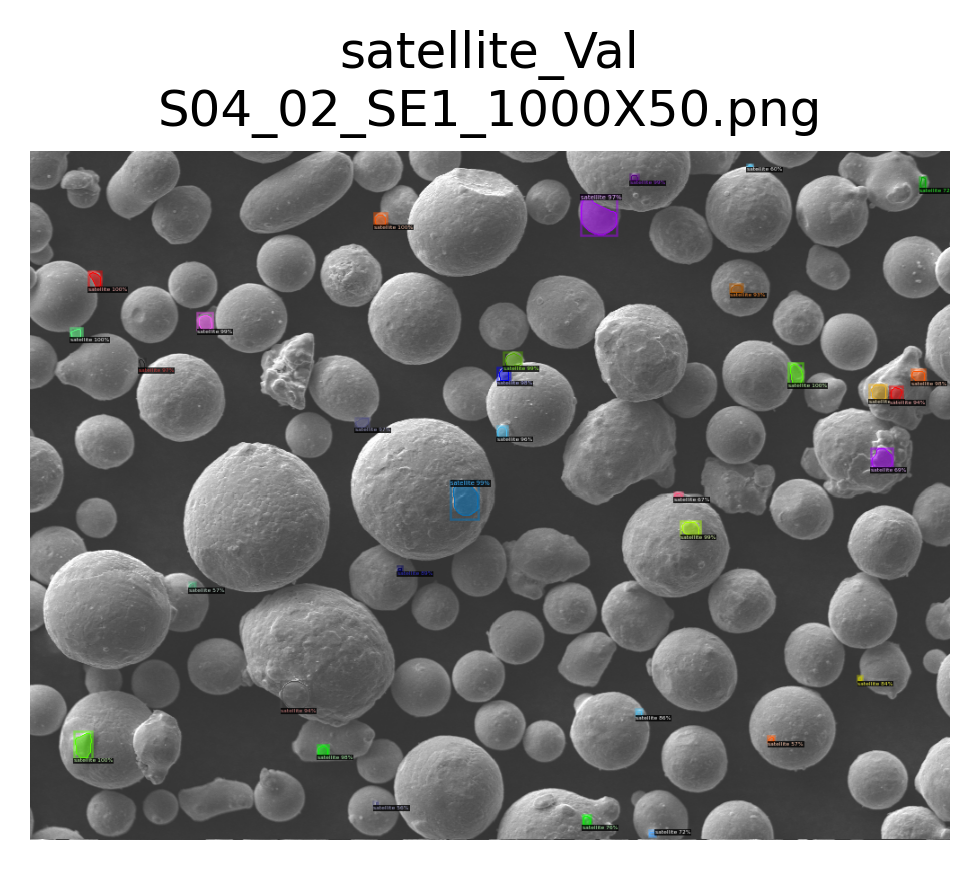

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


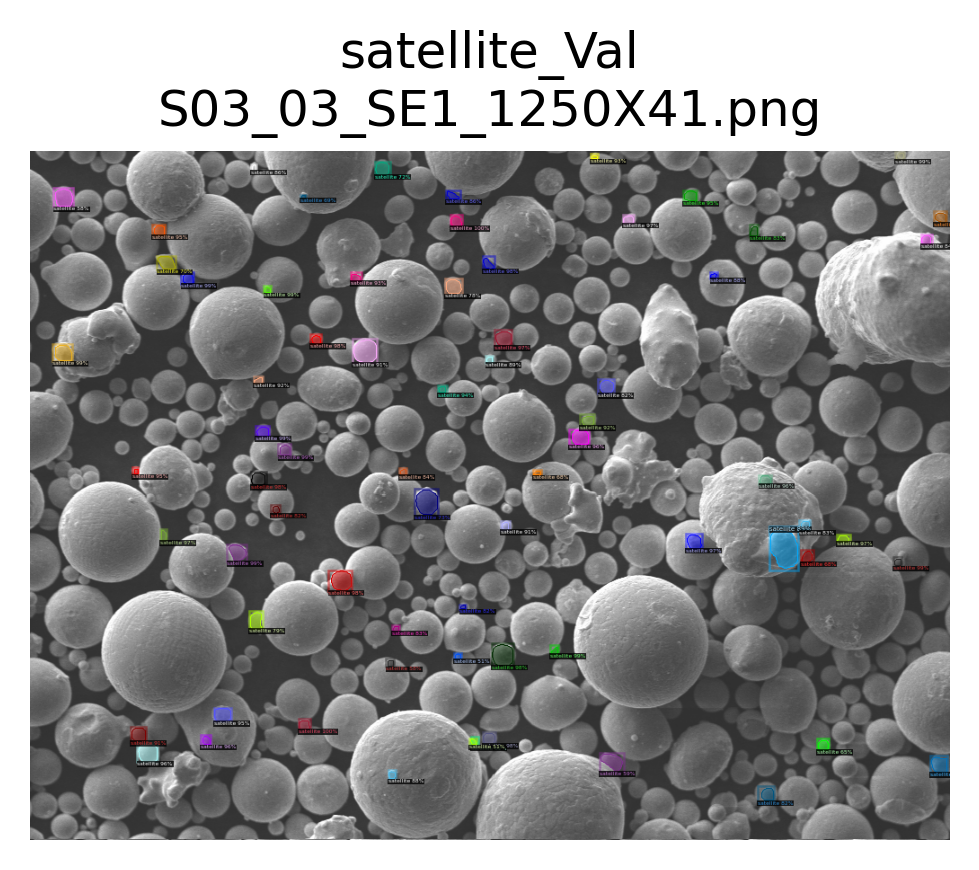

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 70
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


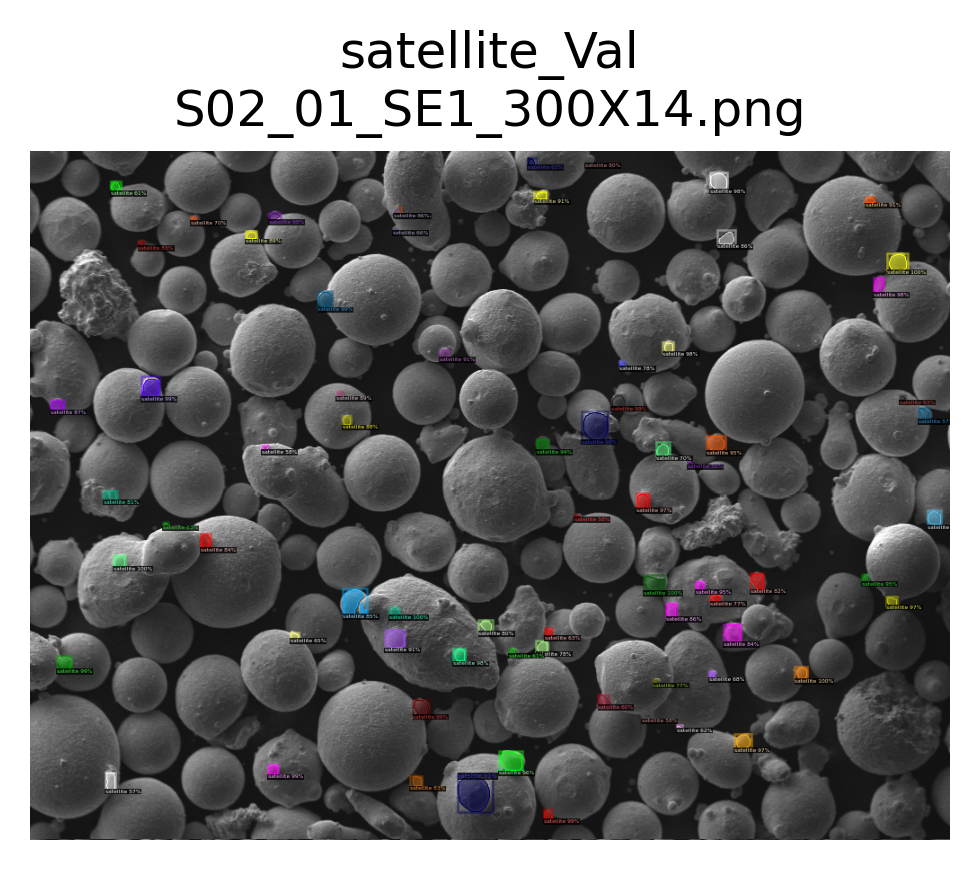

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 72
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


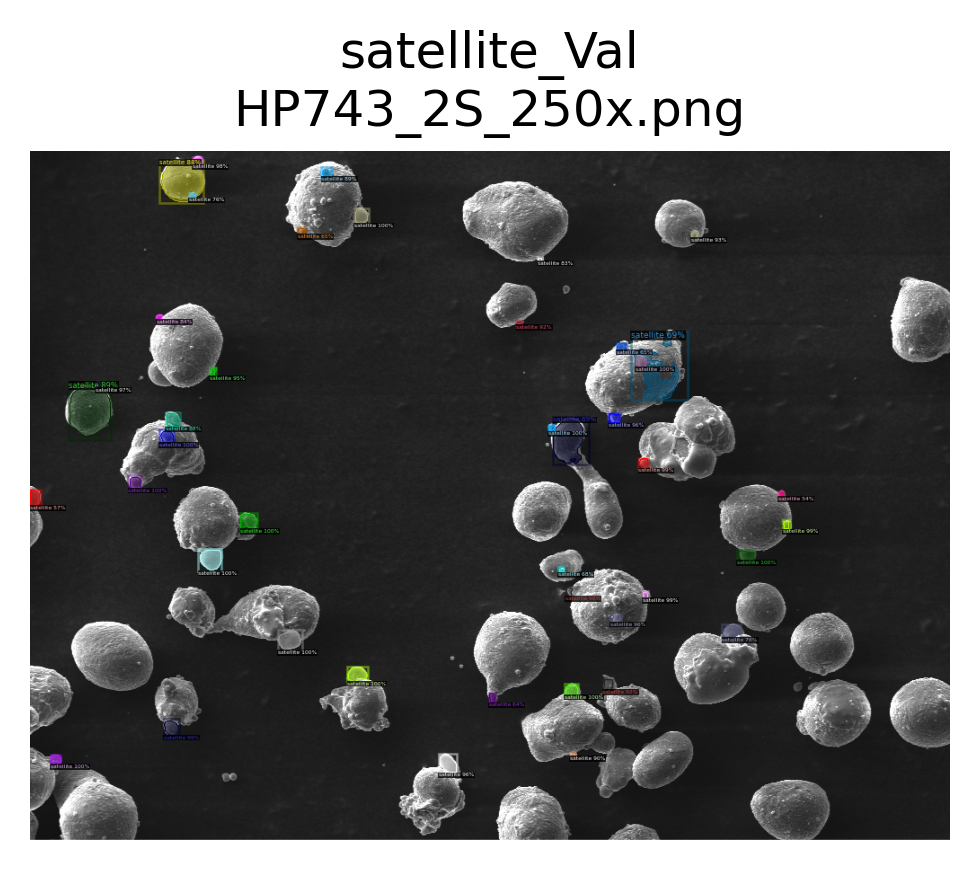

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 43


In [11]:
results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

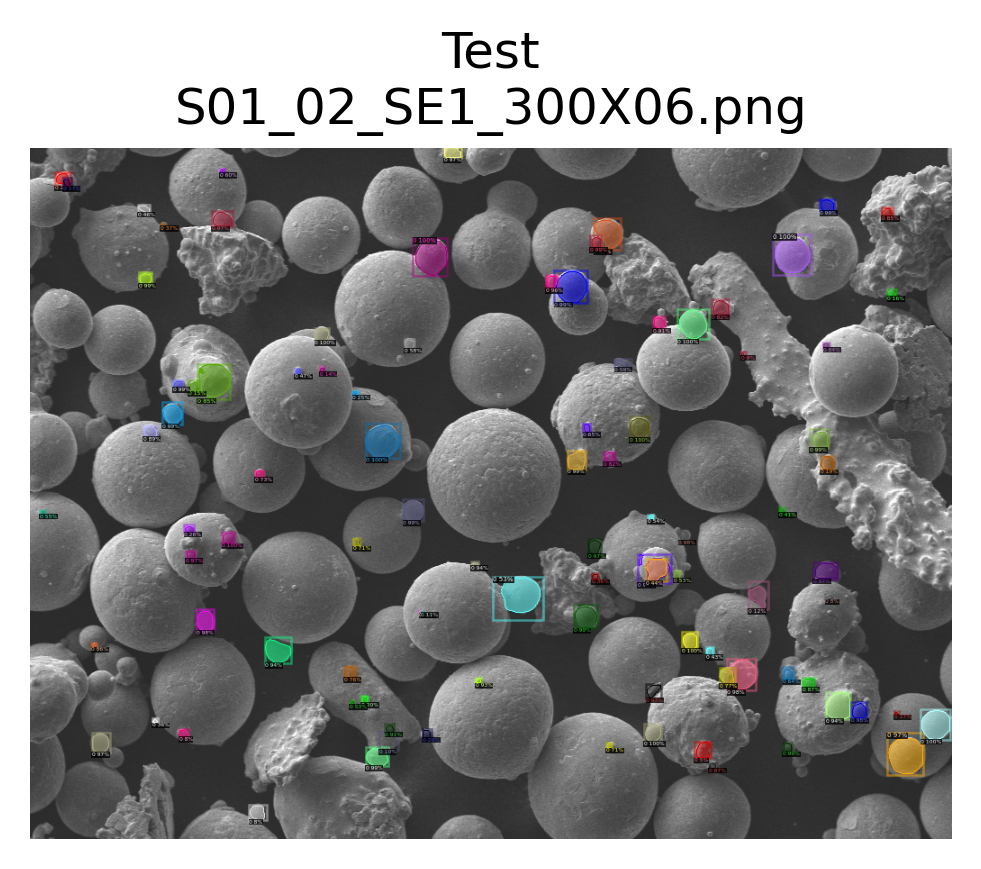

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
